# Análise de difração de amostras finitas com expansão em ondas planas

Medir e analisar o campo acústico perto de amostras absorvedoras finitas é um tema de interesse prático por 2 motivos:

- Toda amostra que medimos ($\textit{in situ}$ ou pela ISO 354) é finita
- Os efeitos de difração impõe desafios à medição e acabam por contaminar de alguma forma os coeficientes de absorção medidos.

Nesta aula, estamos interessados na caracterização $\textit{in situ}$ de absorvedores finitos. Queremos ser capazes de:

- Computar o problema inverso baseado em ondas planas e investigar o espectro de número de onda.
- Reconstruir e analisar o campo acústico próximo à amostra (e na sua superfície: $Z_s$).

Particularmente, vamos estudar o problema da amostra finita em um baffle infinito. Este é um problema de mais fácil caracterização numérica (toy-problem). A validação experimental não é necessariamente fácil, mas está bem documentada.

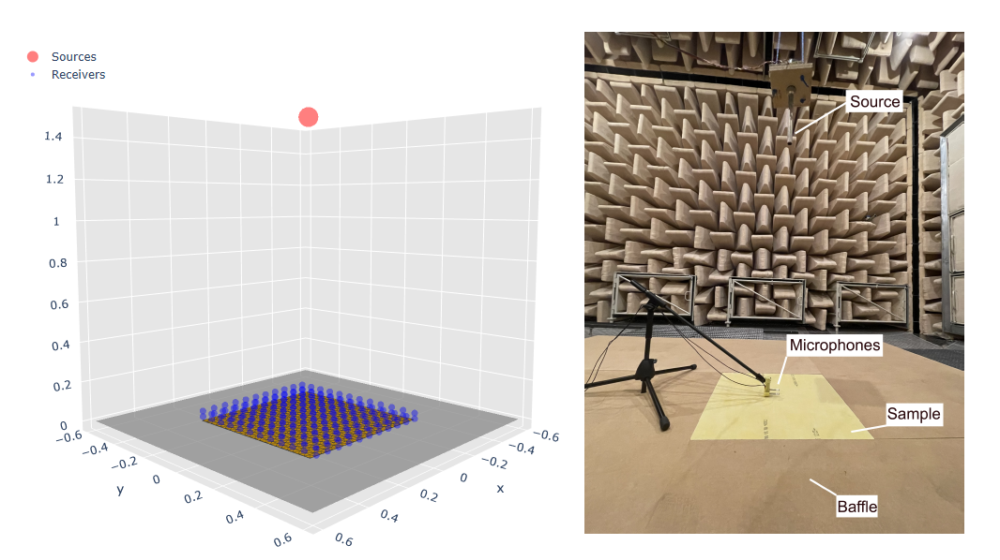


In [69]:
import sys
sys.path.append('D:/Work/dev/finite_bem_simulator/finite_sample')
import matplotlib.pyplot as plt
import matplotlib.tri as tri
import numpy as np
from controlsair import AirProperties, AlgControls, sph2cart, cart2sph
from material import PorousAbsorber
from sources import Source
from receivers import Receiver
from field_bemflush_geo import BEMFlushGeo
import warnings
warnings.filterwarnings("ignore")

sys.path.append('D:/Work/dev/insitu_sim_python/insitu')
# Decomposition
from decomposition_ev_ig import DecompositionEv2, ZsArrayEvIg, filter_evan
from qterm_estimation import ImpedanceDeductionQterm
from scipy.interpolate import griddata

# Simulação BEM

Para uma amostra finita e **localmente reativa** (impedância de superfície cte no espaço), montada num baffle rígido infinito em $z=0$, o campo sonoro pode ser calculado pelo integral de Helmholtz/Huygens. Utiliza-se um BEM simplificado para calcular a pressão sonora na superfície da amostra (fase 1) e a pressão sonora num determinado receptor a $\mathbf{r}$ (fase 2). Para tal, a superfície da amostra é discretizada numa malha de $N$ elementos (seis elementos por comprimento de onda na frequência mais elevada considerada, $2000 \mathrm{~Hz}$). A pressão sonora em cada elemento da malha é considerada constante em toda a superfície do elemento. Assim, a equação integral de Helmholtz/Huygens discretizada é dada por

\begin{equation}
\begin{aligned}
\vartheta(\mathbf{r}) p(\mathbf{r})= A\left[\frac{\mathrm{e}^{-\mathrm{j} k\left|\mathbf{r}_{1}\right|}}{\left|\mathbf{r}_{1}\right|}+\frac{\mathrm{e}^{-\mathrm{j} k\left|\mathbf{r}_{2}\right|}}{\left|\mathbf{r}_{2}\right|}-\frac{\mathrm{j} k}{\tilde{Z}_{s}} \sum_{n=1}^{N} p\left(\mathbf{r}_{s n}\right)\right.  \left. \int_{S_{n}} \frac{\mathrm{e}^{-\mathrm{j} k\left|\mathbf{r}-\mathbf{r}_{s}\right|}}{4 \pi\left|\mathbf{r}-\mathbf{r}_{s}\right|} \mathrm{d} S_{n}\right],
\end{aligned}
\end{equation}
com $\mathbf{r}_{s}$ sendo a variável de integração para cada elemento do absorvedor; $\vartheta(\mathbf{r})$ é 0.5 para $\mathbf{r}$ localizado na superfície absorvente e 1.0 para $\mathbf{r}$ em $z>0$. A impedância de superfície prescrita para o modelo varia com a frequência, mas é a mesma para todos os elementos da malha. Num problema de medição $\textit{in situ}$ com arranjo de microfones, esta é a quantidade que desejamos **reconstruir**. O método de colocação e a quadratura gaussiana são usados para calcular a amplitude complexa da pressão sonora no $n$-ésimo elemento, $p\left(\mathbf{r}_{s n}\right)$, e então, pode-se computar a pressão sonora em qualquer ponto recetor em $z>0$.

A validação experimental do modelo pode ser encotrada em:

 - Brandão, E., Lenzi, A., Cordioli, J., **Estimation and minimization of errors caused by sample size effect in the measurement of the normal absorption coefficient of a locally reactive surface**, Applied Acoustics, 73, 2012.
https://www.sciencedirect.com/science/article/abs/pii/S0003682X11002672
- e logo mais em outra publicação.

 
 Vamos calcular campos acústicos para 3 casos
 
1. **Holografia** (Um arranjo de dupla camada, usado para fazer a holografia)
2. Pontos de **reconstrução** próximos a amostra (para visualização e comparação reconstrução vs. realidade)
3. Pontos de **reconstrução** sobre a superfície da amostra - usados para mensurar a impedância de superfície e o coeficiente de absorção.

# Calcular ou carregar um caso BEM.

In [122]:
#%% Air properties and controls
air = AirProperties(c0 = 343.0, rho0 = 1.21,)
controls = AlgControls(c0 = air.c0, freq_vec = [125, 160, 200, 250, 315, 400, 500, 630, 800, 1000, 1250, 2000]) 

#%% Material
material = PorousAbsorber(air, controls)
material.miki(resistivity=10000)
material.layer_over_rigid(thickness = 100/1000, theta = 0.0)

#%% Source and receivers
r = 1.5
theta = np.deg2rad(90)
phi = np.deg2rad(0)
xs, ys, zs = sph2cart(r, theta, phi)

source = Source(coord = [xs, ys, zs])
receiver = Receiver(coord = [0, 0, 0.013])
#receiver.planar_xz(x_len = 0.8, n_x = 50, z0 = 0.0 , z_len = 0.1, n_z = 10, yr = 0.0)
#receiver.double_planar_array(x_len = 0.57, n_x = 11, y_len = 0.63, n_y = 12, zr = 0.013, dz = 0.029)
receiver.double_rec(z_dist = 0.029)


In [123]:
#%% BEM simulation setup
Lx = 0.6
Ly = 0.6
field = BEMFlushGeo(air = air, controls = controls, material = material,
   sources = source, receivers = receiver,
   min_max_el_size = [0.1, 0.11], Nel_per_wavelenth = 6, bar_mode = 'terminal')
field.rectangle_s(Lx = Lx, Ly = Ly)
field.plot_scene(renderer = 'notebook')

# Computar o campo acústico

O processo de computar o campo acústico em BEM envolve 2 passos:

- Computar a pressão na superfície: envolve: 1.1.) formar a matriz do modelo BEM, em que todos os elementos da malha interferem em todos os outros elementos da malha (integração numérica para formar a matriz); 1.2.) levar em conta a pressão incidente e a matriz para computar a pressão na superfície (inversão matricial - neste problema numérico sem qualquer regularização);
- Computar a pressão nos receptores ($z>0$): envolve a pressão na superfície (computada no passo anterior) e as distâncias entre cada elemento da malha e ponto receptor (integração numérica).


In [124]:
field.psurf()
field.p_fps()
field.ux_fps()
field.uz_fps()
field.save(filename = 'field_el0deg_az0deg_2mic_10cm')

Calculating the surface pressure for each frequency step (method 1): 100%|██████████| 12/12 [01:49<00:00,  9.11s/it]
Processing uz spectrum at each field point: 100%|██████████| 2/2 [00:00<00:00,  9.23it/s]


# Carregar simulação

As simulações podem levar tempo, então nós podemos carregar simulações pré-computadas.

1. Vamos carregar o campo acústico computado para **holografia** e adicionar um pouco de ruído.
2. Vamos carregar o campo acústico computado para termos uma referência para a **reconstrução** feita pela holografia.

In [125]:
theta = 0
phi = 0
base_name = 'field_el' + str(int(theta)) + 'deg_az' + str(int(phi)) + 'deg_'

In [126]:
field_holo = BEMFlushGeo()
field_holo.load(filename = base_name + 'holo_10cm')
field_holo.add_noise(snr = 30, uncorr = False)
field_holo.plot_scene(renderer = 'notebook')

mean -std snr 32.28329402445178 - 5.7030793461880815


In [127]:
print("Shape of receivers: {}".format(field_holo.receivers.coord.shape))
print("Shape of pressure: {}".format(field_holo.pres_s[0].shape))

Shape of receivers: (264, 3)
Shape of pressure: (264, 12)


In [128]:
field_recon = BEMFlushGeo()
field_recon.load(filename = base_name + 'recon_10cm')
field_recon.plot_scene(renderer = 'notebook')

# Plane Wave Expansion - SONAH with diffraction

Neste problema inverso, nosso objetivo é fazer uma expansão em ondas planas (**propagantes** e **evanescentes**) do campo incidente e refletido (difratado). Dessa forma, o campo **incidente** é separado do **refletido** no domínio do **número de onda**. É um problema similar ao anterior (NAH - Near Field Acoustical Holography). Você pode ver mais detalhes da formulação nas seguintes referências:

- (Brandão): https://pubs.aip.org/asa/jasa/article/151/5/3019/2838338/Analysis-of-the-sound-field-above-finite-absorbers?searchresult=1

- (Hald): https://pubs.aip.org/asa/jasa/article/125/4/2105/925276/Basic-theory-and-properties-of-statistically?searchresult=1


Na prática, a expansão em ondas planas é estimada a partir de dados colhidos por um conjunto de sensores. Considere um conjunto de $\mathcal{M}$ pontos receptores,  com cada recetor na coordenada $\mathbf{r}_{\mathrm{m}}$. Os dados medidos nas posições dos microfones podem ser projetados numa base de $\ell$ ondas planas evanescentes e propagantes. Uma equação matricial que representa este problema é dada por

$$
\tilde{\mathbf{p}}=\mathbf{H} \mathbf{x}+\mathbf{n}
$$

em que $\tilde{\mathbf{p}} \in \mathbb{C}^{\mathcal{M}}$ representa a pressão sonora captada pelos microfones $\mathcal{M}$ em uma determinada frequência. $\mathbf{x} \in \mathbb{C}^{\ell}$ são as amplitudes complexas desconhecidas das $\ell$ ondas planas, e $\mathbf{n}$ representa os efeitos do ruído e das inconsistências do modelo. Cada $\ell-$ésima onda plana tem número de onda $\mathbf{k}_{\ell}=\left(k_{x}, k_{y}, k_{z}\right)$, com $k_{z}$ dado por

$$
k_{z}= \begin{cases}\sqrt{k^{2}-\left(k_{x}^{2}+k_{y}^{2}\right)} & \ \ \text { se } \ \  k_{x}^{2}+k_{y}^{2} \leq k^{2}, \\ -\mathrm{j} \sqrt{\left(k_{x}^{2}+k_{y}^{2}\right)-k^{2}} & \ \ \text { se } \ \ k_{x}^{2}+k_{y}^{2}>k^{2}\end{cases}
$$

em que os componentes com $k_{x}^{2}+k_{y}^{2} \leq k^{2}$ representam ondas planas **propagantes**, radiadas para o campo distante, e as componentes com $k_{x}^{2}+k_{y}^{2}>k^{2}$ representam ondas planas **evanescentes**, com a energia propagando paralelamente ao plano $(x, y)$ na direção $k_{x} \hat{x}+k_{y} \hat{y}$, mas decaindo exponencialmente na direção $\hat{z}$:

- As ondas evanescentes **incidentes** decaem no sentido $-z$. as propagantes tem $k_z$ negativo (orientado para a amostra)
- As ondas evanescentes **refletidas** decaem no sentido $+z$. as propagantes tem $k_z$ positvo (orientado para longe da amostra)

Para captar informação sobre os campos sonoros incidente e refletido/espalhado, 

\begin{equation}
\mathbf{H}= \left[ \mathbf{H}_{\text{inc}} \ \mathbf{H}_{\text{ref}}\right] \in \mathbb{C}^{\mathcal{M} \times \ell}
\end{equation}

é a matriz de sensibilidade composta por um dicionário de ondas planas incidentes, $\mathbf{H}_{\text {inc }}$, e refletidas, $\mathbf{H}_{\text {ref }}$. Para um determinado recetor em $\mathbf{r}_{\mathrm{m}}=(x, y, z)$ e um número de onda $\mathbf{k}_{\ell}$, os elementos das matrizes são

$$
\begin{aligned}
& \psi_{\ell}^{\mathrm{inc}}\left(\mathbf{r}_{\mathrm{m}}\right)=\mathrm{e}^{-\mathrm{j}\left(k_{x} x+k_{y} y+k_{z}\left(z-z^{+}\right)\right)} \\
& \psi_{\ell}^{\text {ref }}\left(\mathbf{r}_{\mathrm{m}}\right)=\mathrm{e}^{-\mathrm{j}\left(k_{x} x+k_{y} y-k_{z}\left(z-z^{-}\right)\right)}
\end{aligned}
$$

com $z^{+}$e $z^{-}$sendo as localizações dos **source planes** incidente e refletida. A localização desses planos serve como um equilíbrio entre a regularização do problema inverso e a inclusão da informação das ondas evanescentes. Para distâncias maiores dos planos das fontes virtuais, haverá menos informação sobre as ondas evanescentes, mas o problema inverso torna-se mais fácil de resolver. Além disso, o plano virtual é particularmente crítico para as ondas evanescentes de frequência espacial mais elevada, que decaem mais rapidamente e tendem a ser corrompidas pelo ruído. Por esta razão, a retração de planos virtuais é uma abordagem padrão na holografia acústica. 

Aqui vai uma tentativa visual para tentar representar o problema:

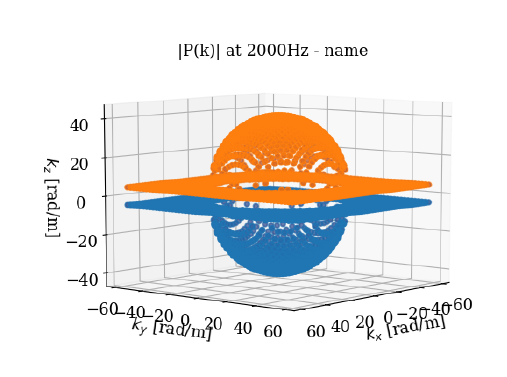


## Fatores importantes no setup:

Neste problema inverso temos:

- um grid $k_x \ \times \ k_y$ para as ondas incidentes (formando $\mathbf{H}_{\text{inc}}$) e outro grid $k_x \ \times \ k_y$ para as ondas refletidas (formando $\mathbf{H}_{\text{ref}}$);
- no grid $k_x \ \times \ k_y$ para as ondas **refletidas**, $k_z$ é calculado de forma que:
    - as ondas evanescentes decaiam para $z \geq z^{-}$ (source plane do refletido - usualmente abaixo da superfície da amostra)
    - as ondas propagantes tenham $k_z \geq 0$ (conduzindo energia para longe do absorvedor) 
- no grid $k_x \ \times \ k_y$ para as ondas **incidentes**, $k_z$ é calculado de forma que:
    - as ondas evanescentes decaiam para $z \leq z^{+}$ (source plane do incidente - usualmente acima do arranjo)
    - as ondas propagantes tenham $k_z \leq 0$ (conduzindo energia para o absorvedor)
    
O que seria uma boa ideia para a localização do **source plane**? 

- Valores grandes fazem com que as ondas evanescentes no seu modelo tenham decaído nos microfones (como se o seu **source plane** estivesse muito longe do ponto de medição. O problema tende a ficar sobre-regularizado porque é como se houvessem apenas ondas propagantes.

A literatura indica que $\epsilon \ \text{max}(\Delta_x, \Delta_y)$, com $1.0 \leq \epsilon \leq 2.5$

## Solução do problema inverso

Normalmente, $\ell \gg \mathcal{M}$ e a Eq. (4) torna-se um problema inverso mal posto e subdeterminado. Neste caso, é resolvido com a regularização de Tikhonov, que pode ser expressa como o problema de otimização dado por

$$
\tilde{\mathbf{x}}=\underset{\mathbf{x}}{\operatorname{argmin}}\left(\|\mathbf{H x}-\tilde{\mathbf{p}}\|_{2}^{2}+\lambda^{2}\|\mathbf{x}\|_{2}^{2}\right),
$$

em que $\tilde{x}$ é a estimativa das amplitudes complexas das $\ell$ ondas planas e $\lambda>0$ é o parâmetro de regularização.  Uma vez que $\tilde{\mathbf{x}}$ é estimado, tem-se uma representação do espectro do número de ondas, que pode ser usado para analisar a direção de viagem do campo incidente e os componentes dispersos devido à reflexão especular e à difração. Além disso, é possível reconstruir o campo sonoro noutros locais na vizinhança da amostra absorvente (pressão sonora e velocidade da partícula). A pressão sonora reconstruída é dada por

$$
\tilde{\mathbf{p}}_{\mathrm{re}}=\mathbf{H}_{\mathrm{re}} \tilde{\mathbf{x}}
$$

em que $\tilde{\mathbf{p}}_{\text {re }}\in \mathbb{C}^{K}$ é o vetor de pressão sonora reconstruído num conjunto de $K$ posições e $\mathbf{H}_{\mathrm{re}}\in \mathbb{C}^{K \times \ell}$ é a matriz de reconstrução que contém as funções de onda planas avaliadas nos pontos de reconstrução. O vetor de velocidade da partícula pode ser calculado a partir da equação de  Euler, $\mathbf{u}=-\nabla p /(\mathrm{j} k \rho c)$, assim

$$
\tilde{\mathbf{u}}_{\mathrm{re}}=\frac{-1}{\mathrm{j} k \rho c} \nabla \mathbf{H}_{\mathrm{re}} \tilde{\mathbf{x}}
$$

em que $\nabla \mathbf{H}_{\mathrm{re}}\in \mathbb{C}^{K \times \ell}$ contém o gradiente da matriz de reconstrução, $\rho$ é a densidade do ar e $c$ é a velocidade do som. 

Além dos pontos de reconstrução usados, para medições in situ, é interessante reconstruir a pressão sonora e o componente normal da velocidade da partícula num ponto, $\mathbf{r}_{s}$, ou num conjunto de pontos na superfície da amostra. Assim, a impedância de superfície reconstruída pode ser estimada como

$$
\tilde{Z}_{s}\left(\mathbf{r}_{s}\right)=-\frac{1}{\rho c} \frac{\tilde{p}\left(\mathbf{r}_{s}\right)}{\tilde{u}_{n}\left(\mathbf{r}_{s}\right)}
$$
e o coeficiente de absorção é

$$
\alpha=1-\left|\frac{\bar{Z}_{s} \cos (\theta)-1}{\bar{Z}_{s} \cos (\theta)+1}\right|^{2}
$$
em que $\theta$ é o ângulo de incidência e $\bar{Z}_{s}$ é a impedância pontual ou a média espacial de várias impedâncias de superfície reconstruídas num grid de pontos. Isto é feito para aliviar o efeito dos erros presentes no processo de reconstrução  e para obter um valor único para $Z_{s}$. Normalmente, o grid é suficientemente pequeno para garantir variações espaciais não muito grandes de $Z_{s}$ na gama de frequências de interesse.



In [129]:
zs_ded = ZsArrayEvIg(p_mtx = field_holo.pres_s[0], controls = field_holo.controls, material = field_holo.material, 
                     receivers = field_holo.receivers, regu_par = 'l-curve')
zs_ded.prop_dir(n_waves = 642, plot = False)
zs_ded.pk_tikhonov_ev_ig(f_ref=1, f_inc=1, factor=1.5, z0 = 13/1000+29/1000, zref = 0.0, plot_l=False, method = 'Tikhonov')
zs_ded.zs(Lx = 0.1, Ly = 0.1, n_x = 21, n_y = 21, theta = [np.deg2rad(theta)]);

You choose L-curve to find optimal regularization parameter
You choose L-curve to find optimal regularization parameter


Calculating Tikhonov inversion (with evanescent waves and irregular grid)...: 100%|██████████| 12/12 [00:05<00:00,  2.25it/s]
Reconstructing sound field...: 100%|██████████| 12/12 [00:04<00:00,  2.73it/s]


## Vamos comparar também com a técnica de 2 microfones

In [130]:
field_2mic = BEMFlushGeo()
field_2mic.load(filename = base_name + '2mic_10cm')
zs_ded_2mic = ImpedanceDeductionQterm(p_mtx = field_2mic.pres_s[0], controls = field_2mic.controls, 
                     receivers = field_2mic.receivers, source = field_2mic.sources)
zs_ded_2mic.pwa_pp()

# Absorption coefficient

É uma reconstrução relativamente descente e menos sensível ao tamanho finito da amostra que outros métodos in situ. Lembre-se que esta amostra dada em aula tem apenas $40$ cm de lado e que a fonte está a $1.5$ m de distância do centro da amostra.

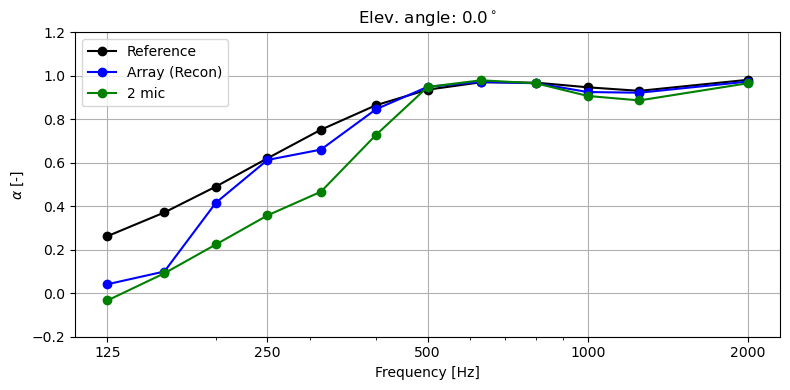

In [131]:
plt.figure(figsize = (8,4))
plt.semilogx(field_holo.controls.freq, field_holo.material.alpha, '-ok', label = 'Reference')
plt.semilogx(zs_ded.controls.freq, zs_ded.alpha[0,:], '-ob', label = 'Array (Recon)')
plt.semilogx(zs_ded_2mic.controls.freq, zs_ded_2mic.alpha_pwa_pp, '-og', label = '2 mic')
plt.legend()
plt.grid()
plt.ylim((-0.2, 1.2))
plt.xticks(ticks = [125,250,500,1000,2000], labels = ['125','250','500','1000','2000'], rotation = 0)
plt.xlabel(r'Frequency [Hz]')
plt.ylabel(r'$\alpha$ [-]')
plt.title("Elev. angle: {:.1f}$^\circ$".format(theta))
plt.tight_layout();

# $k$-space

Note:

- Nós separamos onda incidente e refletida (difratada) no domínio do número de onda;
- No campo incidende, nós temos primordialmente uma componente associada a direção de viagem da onda incidente;
- No campo refletido vamos ter uma componente importante associada a direção de viagem da onda refletida especularmente e outras componentes associadas ao fenômeno de difração no absorvedor finito;
- Algumas dessas importantes componentes são evanescentes;
- Elas também aparecem na solução analítica do espectro de número de onda (para uma amostra finita);
- Essas componentes tendam a não estar presentes caso a amostra seja muito grande ou infinita;

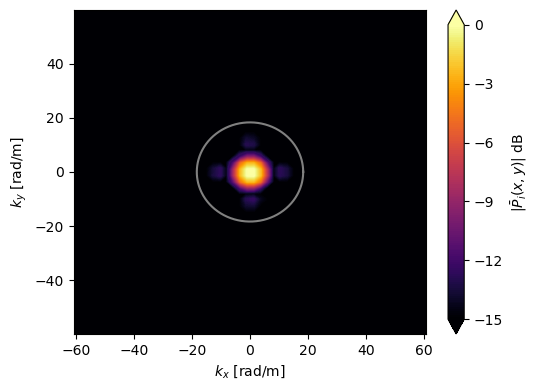

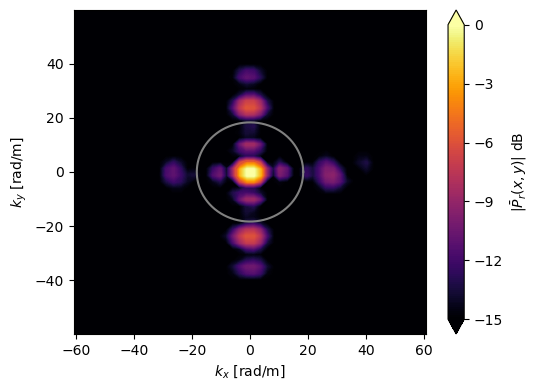

In [132]:
zs_ded.plot_pkmap_v2(freq = 1000, db = True, dinrange = 15, color_code='inferno', fileformat = 'pdf', 
    fig_title='', plot_incident = True, save = False, path = '', fname = 'ref_wns', dpi=600, figsize = (5.5,4))

In [147]:
fig2, trace2 = zs_ded.plot_directivity(freq = 1000, color_method = 'dB', radius_method = 'dB', dinrange = 30,
        color_code = 'jet', view = 'iso_z',  renderer = "notebook", true_directivity = False)
fig2.show()

# Reconstruction

Vamos avaliar o campo de pressão sonora e intensidades reconstruída e de referência.

In [133]:
zs_ded.reconstruct_pu(field_recon.receivers, compute_uxy = True)

Reconstructing sound field...: 100%|██████████| 12/12 [00:04<00:00,  2.64it/s]


In [19]:
print(field_recon.controls.freq)

[ 125  160  200  250  315  400  500  630  800 1000 1250 2000]


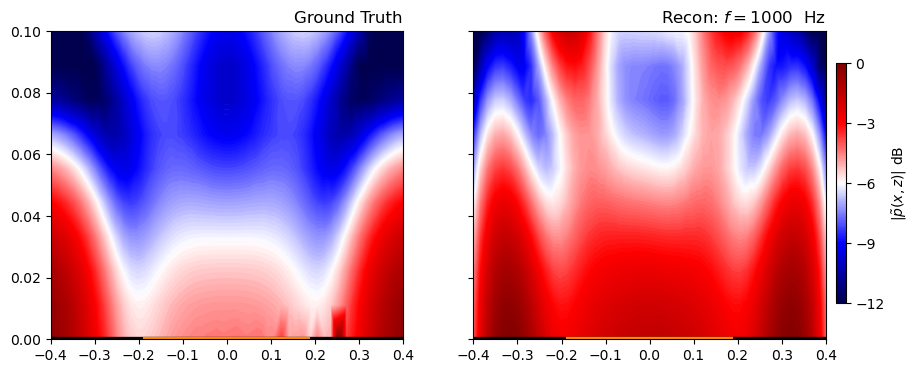

In [134]:
idf = 9
dinrange = 12
baffle_limits = 0.8

fig, ax = plt.subplots(1, 2, figsize = (10,4))

counter = 0
for jl in np.arange(2):
    color_par = get_color_par(field_recon.pres_s[0][:,idf], dinrange)
    p = plot_map_ax(ax[0], field_recon.receivers.coord[:,0], field_recon.receivers.coord[:,2], color_par, dinrange)
    plot_sample(ax[0], 0.4, dl = 0.015)
    ax[0].set_xlim((-baffle_limits/2, baffle_limits/2))

    color_par = get_color_par(zs_ded.p_recon[:,idf], dinrange)
    p = plot_map_ax(ax[1], zs_ded.fpts.coord[:,0], zs_ded.fpts.coord[:,2], color_par, dinrange)
    plot_sample(ax[1], 0.4, dl = 0.015)
    ax[1].set_xlim((-baffle_limits/2, baffle_limits/2))

plt.setp(ax[1].get_yticklabels(), visible=False)
local = 'right'
ax[0].set_title(r'Ground Truth', loc=local)
ax[1].set_title(r'Recon: $f = {}$  Hz'.format(int(controls.freq[idf])), loc=local)
   
cbar_ax_start = 0.2
cbar_ax = fig.add_axes([0.91, cbar_ax_start, 0.010, 1-2*cbar_ax_start])
fig.colorbar(p, cax=cbar_ax, shrink=1, ticks=np.arange(-dinrange, 3, 3), label = r'$|\tilde{p}(x, z)|$ dB');

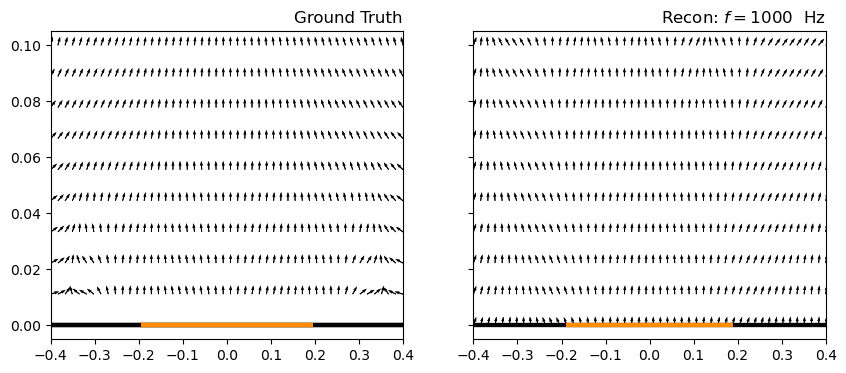

In [135]:
idf = 9
dinrange = 15
baffle_limits = 0.8
x = field_recon.receivers.coord[:,0]
z = field_recon.receivers.coord[:,2]

fig, ax = plt.subplots(1, 2, figsize = (10,4))
for jl in np.arange(2):
    plot_sample(ax[0], 0.4, dl = 0.01)
    ax[0].set_xlim((-baffle_limits/2, baffle_limits/2))
    pres = field_recon.pres_s[0][:,idf]
    ux = field_recon.ux_s[0][:,idf]
    uz = field_recon.uz_s[0][:,idf]
    Ix_f = 0.5*np.real(pres * np.conj(ux))
    Iz_f = 0.5*np.real(pres * np.conj(uz))
    q = plot_intensity(ax[0], x, z, Ix_f, Iz_f, normalize = True)
    plot_sample(ax[0], 0.4, dl = 0.01)
    ax[0].set_xlim((-baffle_limits/2, baffle_limits/2))       
        
    # P+E
    pres = zs_ded.p_recon[:,idf]
    ux = zs_ded.ux_recon[:,idf]
    uz = zs_ded.uz_recon[:,idf]
    Ix_pe = 0.5*np.real(pres * np.conj(ux))
    Iz_pe = 0.5*np.real(pres * np.conj(uz))
    plot_intensity(ax[1], x, z, Ix_pe, Iz_pe, normalize = True)
    plot_sample(ax[1], 0.4, dl = 0.015)
    ax[1].set_xlim((-baffle_limits/2, baffle_limits/2))  
plt.setp(ax[1].get_yticklabels(), visible=False)
ax[0].set_title(r'Ground Truth', loc=local)
ax[1].set_title(r'Recon: $f = {}$  Hz'.format(int(controls.freq[idf])), loc=local);

# Auxiliary functions

In [112]:
def plot_sample(ax, l, dl):
    sample = np.linspace(-l/2+dl, l/2-dl, 1000)
    baffle = np.linspace(-1,1,1000)
    ax.plot(baffle, np.zeros(len(sample)), '-k', linewidth = 3)
    ax.plot(sample, np.zeros(len(sample)), '-', linewidth = 3, color = 'darkorange')

def plot_map_ax(ax, x, z, color_par, dinrange):
    triang = tri.Triangulation(x, z)
    p = ax.tricontourf(triang, color_par, np.arange(-dinrange, 0.1, 0.1),
        vmin = -dinrange, vmax = 0, cmap = 'seismic')
    for c in p.collections:
        c.set_edgecolor("face")
    return p

def plot_intensity(ax, x, z, Ix, Iz, normalize = False):
    I = np.sqrt(Ix**2+Iz**2)
    if normalize == False:
        q = ax.quiver(x, z, Ix, Iz, units='width', color = 'k')
    else:
        q = ax.quiver(x, z, Ix/I, Iz/I, units='width', color = 'k')
    return q

def get_color_par(pres, dinrange):
    # color parameter
    color_par = 20*np.log10(np.abs(pres)/np.amax(np.abs(pres)))
    color_par[color_par<-dinrange] = -dinrange
    return color_par

def plot_colormap(x, z, pres, dinrange = 15):
        """Plots a color map of the pressure field.

        Parameters
        ----------
        x : numpy ndArray
            x-coord of the receivers.
        z : numpy ndArray
            z-coord of the receivers.
        pres : numpy ndArray
            Sound pressure at receivers.
        dinrange : float
            Dinamic range of the color map
        Returns
        ---------
        plt : Figure object
        """
        # color parameter
        color_par = get_color_par(pres, dinrange)
        # Create triangulazition
        triang = tri.Triangulation(x, z)
        # Figure
        fig, ax = plt.subplots(figsize = (7,5)) #fig = plt.figure() #figsize=(8, 8)
        p = ax.tricontourf(triang, color_par, np.arange(-dinrange, 0.1, 0.1),
                            vmin = -dinrange, vmax = 0, cmap = 'seismic')
        ax.set_xticks([])
        ax.set_yticks([])
        return fig

# Processed experimental data

Não está no repositótio (apenas pra aula)

In [141]:
zs_ded_exp_pp = ZsArrayEvIg()
zs_ded_exp_pp.load(path = 'D:/Work/UFSM/Pesquisa/insitu_arrays/exp_data_gabriel_master/PET_grooved_plate/', 
                   filename = 'zsded_PET_grooved_plate')
zs_ded_exp_pp.compute_normals()
zs_ded_exp_pp.correct_normals()
zs_ded_exp_so = ZsArrayEvIg()
zs_ded_exp_so.load(path = 'D:/Work/UFSM/Pesquisa/insitu_arrays/exp_data_gabriel_master/sonex/', 
                   filename = 'zsded_sonex')
zs_ded_exp_so.compute_normals()
zs_ded_exp_so.correct_normals()

You choose L-curve to find optimal regularization parameter
You choose L-curve to find optimal regularization parameter
You choose L-curve to find optimal regularization parameter
You choose L-curve to find optimal regularization parameter


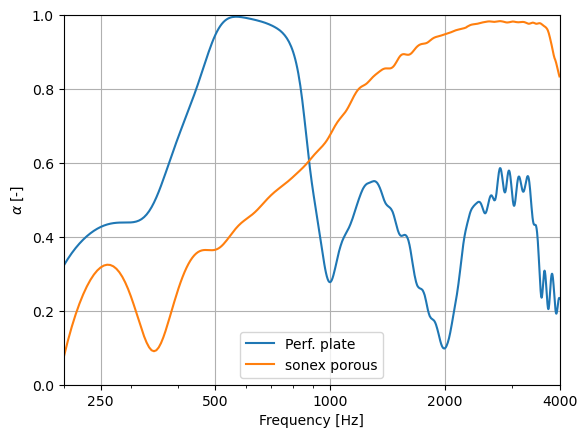

In [144]:
plt.figure()
plt.semilogx(zs_ded_exp_pp.controls.freq, zs_ded_exp_pp.alpha[0,:], label = 'Perf. plate')
plt.semilogx(zs_ded_exp_so.controls.freq, zs_ded_exp_so.alpha[0,:], label = 'sonex porous')
plt.legend()
plt.ylim((0, 1.0))
plt.xlim((200, 4000))
plt.grid()
plt.xticks(ticks = [250,500,1000,2000,4000], labels = ['250','500','1000','2000','4000'], rotation = 0)
plt.xlabel(r'Frequency [Hz]')
plt.ylabel(r'$\alpha$ [-]');

In [146]:
fig2, trace2 = zs_ded_exp_pp.plot_directivity(freq = 1000, color_method = 'dB', radius_method = 'dB', dinrange = 30,
        color_code = 'jet', view = 'iso_z',  renderer = "notebook", true_directivity = False)
fig2.show()

fig2, trace2 = zs_ded_exp_so.plot_directivity(freq = 1000, color_method = 'dB', radius_method = 'dB', dinrange = 30,
        color_code = 'jet', view = 'iso_z',  renderer = "notebook", true_directivity = False)
fig2.show()

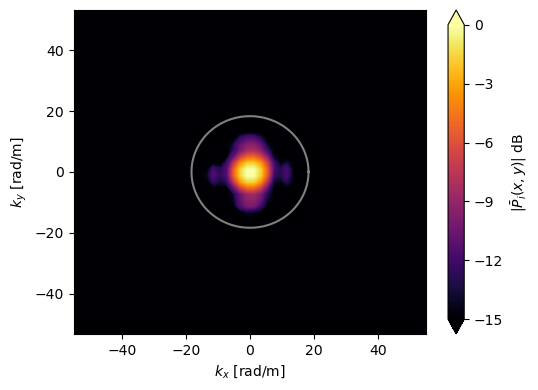

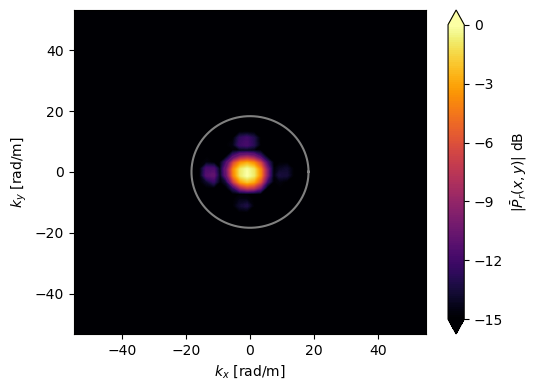

In [148]:
zs_ded_exp_so.plot_pkmap_v2(freq = 1000, db = True, dinrange = 15, color_code='inferno', fileformat = 'pdf', 
    fig_title='', plot_incident = True, save = False, path = '', fname = 'ref_wns', dpi=600, figsize = (5.5,4))